<a href="https://colab.research.google.com/github/ravi3222/Image-Clustering/blob/master/Image_Clustering_ResNet50_KMeans.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [1]:
!pip install keras

In [2]:
import cv2
import glob
import numpy as np

import time
import os, os.path
import random
import glob
from keras import applications
import matplotlib
import matplotlib.pyplot as plt
from sklearn.model_selection import train_test_split
from sklearn.cluster import KMeans
from sklearn.mixture import GaussianMixture
from sklearn.decomposition import PCA
print("[INFO] Loading libraries done")

Using TensorFlow backend.


[INFO] Loading libraries done


In [0]:
# this part will prevent tensorflow to allocate all the avaliable GPU Memory
# backend
import tensorflow as tf
from keras import backend as k

# Don't pre-allocate memory; allocate as-needed
config = tf.ConfigProto()
config.gpu_options.allow_growth = True

# Create a session with the above options specified.
k.tensorflow_backend.set_session(tf.Session(config=config))

In [4]:
from google.colab import drive
drive.mount('/content/gdrive')

Go to this URL in a browser: https://accounts.google.com/o/oauth2/auth?client_id=947318989803-6bn6qk8qdgf4n4g3pfee6491hc0brc4i.apps.googleusercontent.com&redirect_uri=urn%3Aietf%3Awg%3Aoauth%3A2.0%3Aoob&scope=email%20https%3A%2F%2Fwww.googleapis.com%2Fauth%2Fdocs.test%20https%3A%2F%2Fwww.googleapis.com%2Fauth%2Fdrive%20https%3A%2F%2Fwww.googleapis.com%2Fauth%2Fdrive.photos.readonly%20https%3A%2F%2Fwww.googleapis.com%2Fauth%2Fpeopleapi.readonly&response_type=code

Enter your authorization code:
··········
Mounted at /content/gdrive


In [5]:
from keras.preprocessing import image
import keras
from keras.applications.vgg16 import VGG16
from keras.applications.vgg16 import preprocess_input
import numpy as np

model = keras.applications.resnet50.ResNet50(weights='imagenet', include_top=False)
model.summary()


/usr/local/lib/python3.6/dist-packages/keras_applications/resnet50.py:265: UserWarning: The output shape of `ResNet50(include_top=False)` has been changed since Keras 2.2.0.
  warnings.warn('The output shape of `ResNet50(include_top=False)` '


94658560/94653016 [==============================] - 17s 0us/step
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_1 (InputLayer)            (None, None, None, 3 0                                            
__________________________________________________________________________________________________
conv1_pad (ZeroPadding2D)       (None, None, None, 3 0           input_1[0][0]                    
__________________________________________________________________________________________________
conv1 (Conv2D)                  (None, None, None, 6 9472        conv1_pad[0][0]                  
__________________________________________________________________________________________________
bn_conv1 (BatchNormalization)   (None, None, None, 6 256         conv1[0][0]                      
___________________________________________

In [6]:
img_path = "/content/gdrive/My Drive/dataset"
folders = glob.glob(img_path)
imagenames_list = []
for folder in folders:
    for f in glob.glob(folder+'/*.jpg'):
        imagenames_list.append(f)
        
print("[INFO] Total No. of images: {}".format(len(imagenames_list)))

[INFO] Total No. of images: 172


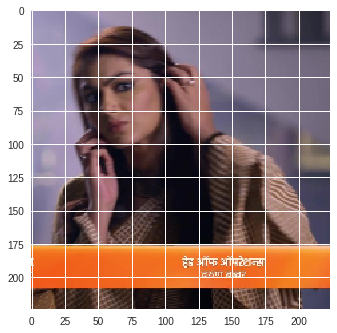

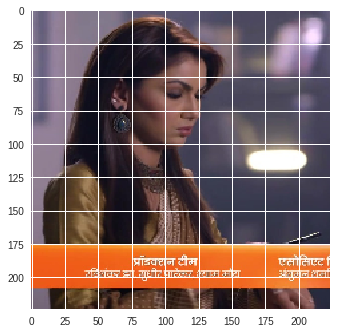

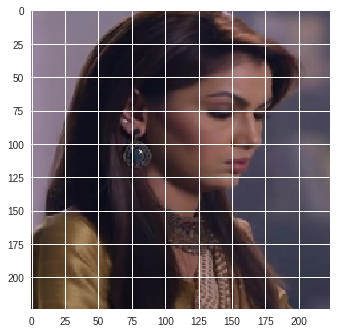

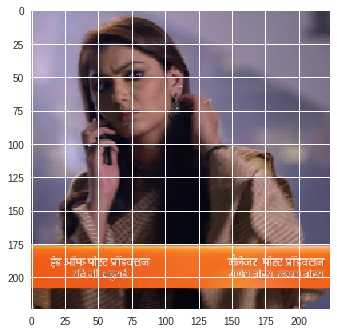

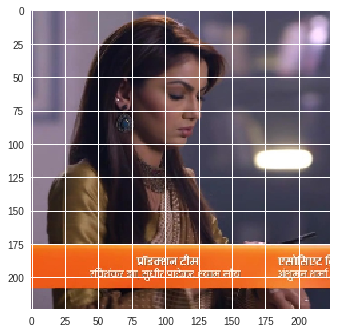

...

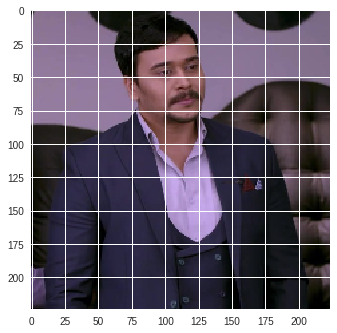

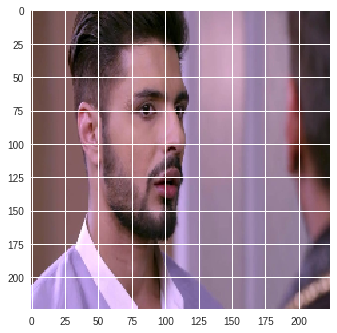

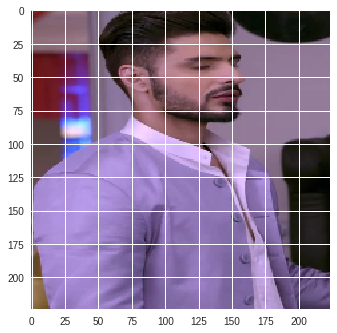

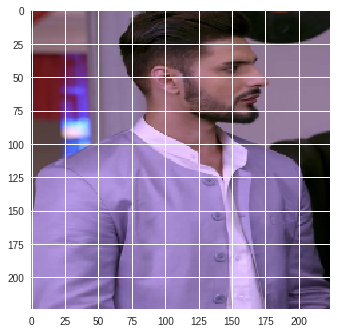

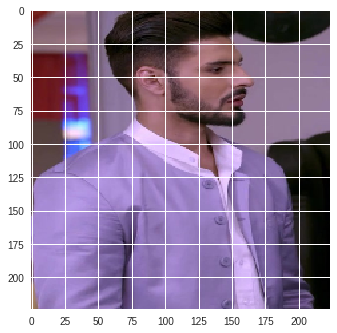

In [10]:
resnet_feature_list = []

for image_path in imagenames_list:
    img = image.load_img(image_path, target_size=(224, 224))
    plt.imshow(img)
    plt.show()
    
    img_data = image.img_to_array(img)
    img_data = np.expand_dims(img_data, axis=0)
    img_data = preprocess_input(img_data)

    resnet_feature = model.predict(img_data)
    resnet_feature_np = np.array(resnet_feature)
    resnet_feature_list.append(resnet_feature_np.flatten())

resnet_feature_list_np = np.array(resnet_feature_list)

In [25]:
resnet_feature_np.shape

(1, 7, 7, 2048)

In [0]:
from sklearn import metrics

In [0]:
kmeans = KMeans(n_clusters=10,init='k-means++', random_state=0).fit(resnet_feature_list_np)

In [18]:
labels = kmeans.labels_
print(labels)

[9 9 8 9 9 9 8 9 8 8 9 9 8 4 8 8 2 4 7 9 5 4 4 4 5 4 4 5 5 5 5 2 2 5 5 4 4
 4 4 4 1 1 1 1 1 1 1 1 1 5 3 3 1 3 1 5 3 1 1 1 3 3 8 8 8 8 8 8 8 8 3 8 3 7
 3 7 3 7 8 8 7 7 7 7 7 7 7 7 7 7 2 2 8 2 2 8 2 2 8 2 8 6 6 6 3 8 3 8 6 8 6
 0 6 6 8 3 3 6 3 0 0 3 3 0 0 0 0 3 0 0 0 0 0 0 0 0 0 0 0 0 0 6 8 0 0 8 0 0
 0 0 3 0 0 0 3 0 6 6 0 6 3 8 3 8 0 3 8 3 0 3 3 3]


In [19]:
metrics.silhouette_score(resnet_feature_list_np, labels, metric='euclidean')

0.15616512

In [20]:
y_kmeans = kmeans.predict(resnet_feature_list_np)
print(y_kmeans)

[9 9 8 9 9 9 8 9 8 8 9 9 8 4 8 8 2 4 7 9 5 4 4 4 5 4 4 5 5 5 5 2 2 5 5 4 4
 4 4 4 1 1 1 1 1 1 1 1 1 5 3 3 1 3 1 5 3 1 1 1 3 3 8 8 8 8 8 8 8 8 3 8 3 7
 3 7 3 7 8 8 7 7 7 7 7 7 7 7 7 7 2 2 8 2 2 8 2 2 8 2 8 6 6 6 3 8 3 8 6 8 6
 0 6 6 8 3 3 6 3 0 0 3 3 0 0 0 0 3 0 0 0 0 0 0 0 0 0 0 0 0 0 6 8 0 0 8 0 0
 0 0 3 0 0 0 3 0 6 6 0 6 3 8 3 8 0 3 8 3 0 3 3 3]


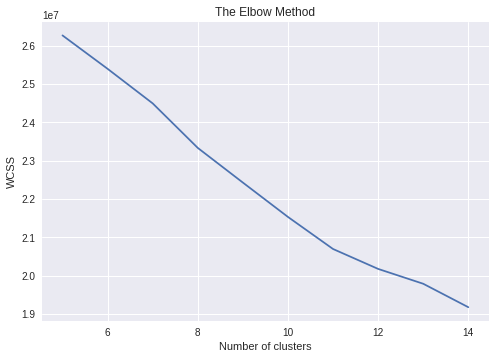

In [27]:
wcss = []

for i in range(5,15):
    kmeans = KMeans(n_clusters=i).fit(resnet_feature_list_np)
    #kmeans.fit_transform()
    wcss.append(kmeans.inertia_)
    
plt.figure()
plt.plot(range(5,15), wcss)
plt.title('The Elbow Method')
plt.xlabel('Number of clusters')
plt.ylabel('WCSS')
plt.show()

In [0]:
k=5
cmap = matplotlib.cm.get_cmap('plasma')

kmeans = KMeans(n_clusters = k)
y_kmeans = kmeans.fit_predict(X)

labels = [('Cluster ' + str(i+1)) for i in range(k)]

# Plotting the clusters
plt.figure()
for i in range(k):
    plt.scatter(X[y_kmeans == i, 0], X[y_kmeans == i, 1], s = 20, c = cmap(i/k), label = labels[i]) 

    
plt.scatter(kmeans.cluster_centers_[:,0], kmeans.cluster_centers_[:,1], s = 100, c = 'black', label = 'Centroids', marker = 'X')
plt.title('Kmeans cluster plot')
plt.legend()
plt.show()

In [0]:
DIR_NAME = img_path

for n in range(10):
    print("\n --- Images from cluster #%d ---" % n)

    for i in np.argwhere(y_kmeans == n):
        if i != -1:
            print("Image %s" % images[i])
            img = cv2.imread('%s/%s' % (DIR_NAME, image[i]))
            plt.axis('off')
            plt.imshow(cv2.cvtColor(img, cv2.COLOR_BGR2RGB))
            plt.show()